In [1]:
import os
import sys
import json
import argparse

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib

from glob import glob
from nilearn import plotting
from nilearn import datasets

from nilearn.glm.second_level import SecondLevelModel
from nilearn.glm.second_level import make_second_level_design_matrix

In [2]:
task_label = 'tonecat'

project_dir = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 'FLT/')
bidsroot = os.path.join(project_dir, 'data_denoised') #'data_bids')
deriv_dir = os.path.join(project_dir, 'derivatives')
nilearn_dir = os.path.join(bidsroot, 'derivatives', 'nilearn')
if not os.path.exists(nilearn_dir):
        os.makedirs(nilearn_dir)

### Build the group-level design matrix

#### Read the `participants.tsv` file from the BIDS root directory

In [5]:
participants_fpath = os.path.join(bidsroot, 'participants.tsv')
participants_df = pd.read_csv(participants_fpath, sep='\t')

# subjects to ignore (not fully processed, etc.)
ignore_subs = ['sub-FLT27', 
              ]
participants_df.drop(participants_df[participants_df.participant_id.isin(ignore_subs)].index,
                     inplace=True)

# re-sort by participant ID
participants_df.sort_values(by=['participant_id'], 
                            ignore_index=True, 
                            inplace=True)

In [6]:
participants_fpath

'/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/participants.tsv'

In [7]:
print(participants_df)

   participant_id  age sex         group  FFR_id
0       sub-FLT02   21   F  non-Mandarin  1002.0
1       sub-FLT03   25   F      Mandarin  2002.0
2       sub-FLT04   21   F  non-Mandarin  1003.0
3       sub-FLT05   26   M      Mandarin  3010.0
4       sub-FLT06   21   F  non-Mandarin  3001.0
5       sub-FLT07   22   M      Mandarin  2003.0
6       sub-FLT08   23   F      Mandarin  2005.0
7       sub-FLT09   30   F  non-Mandarin  3002.0
8       sub-FLT10   23   F      Mandarin  2006.0
9       sub-FLT11   20   F  non-Mandarin  1005.0
10      sub-FLT12   20   F  non-Mandarin  3004.0
11      sub-FLT13   23   F  non-Mandarin  3005.0
12      sub-FLT14   23   M  non-Mandarin  3006.0
13      sub-FLT15   22   M      Mandarin  2010.0
14      sub-FLT17   29   F      Mandarin     NaN
15      sub-FLT18   24   M      Mandarin  2016.0
16      sub-FLT19   24   M      Mandarin  2018.0
17      sub-FLT20   26   F  non-Mandarin  3008.0
18      sub-FLT21   21   M      Mandarin  2011.0
19      sub-FLT22   

In [8]:
# create group-specific lists of subject IDs
sub_list_mand = list(participants_df.participant_id[participants_df.group=='Mandarin'])
sub_list_nman = list(participants_df.participant_id[participants_df.group=='non-Mandarin'])

#### Create design matrixes

In [9]:
# difference between groups
subjects_label = list(participants_df.participant_id)
groups_label = list(participants_df.group)
design_mat_groupdiff = pd.DataFrame({'Mand': groups_label,
                                     'NMan': groups_label,
                                    }
                                   )

design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'Mandarin'] = 1
design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'non-Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'non-Mandarin'] = 1
design_mat_groupdiff = design_mat_groupdiff.astype('int')
print(design_mat_groupdiff)

    Mand  NMan
0      0     1
1      1     0
2      0     1
3      1     0
4      0     1
5      1     0
6      1     0
7      0     1
8      1     0
9      0     1
10     0     1
11     0     1
12     0     1
13     1     0
14     1     0
15     1     0
16     1     0
17     0     1
18     1     0
19     1     0
20     1     0
21     1     0
22     0     1
23     1     0
24     0     1
25     0     1


In [10]:
print(subjects_label)

['sub-FLT02', 'sub-FLT03', 'sub-FLT04', 'sub-FLT05', 'sub-FLT06', 'sub-FLT07', 'sub-FLT08', 'sub-FLT09', 'sub-FLT10', 'sub-FLT11', 'sub-FLT12', 'sub-FLT13', 'sub-FLT14', 'sub-FLT15', 'sub-FLT17', 'sub-FLT18', 'sub-FLT19', 'sub-FLT20', 'sub-FLT21', 'sub-FLT22', 'sub-FLT23', 'sub-FLT24', 'sub-FLT25', 'sub-FLT26', 'sub-FLT28', 'sub-FLT30']


### Get files

In [11]:
contrast_label = 'sound'
fwhm = 0.00
space_label = 'MNI152NLin2009cAsym'
model_label = 'stimulus_per_run_LSS'
mask_label = 'gm' # 'gm-thr90'
cond_label = 'tone'
search_radmm = 9
l1_dir = os.path.join(bidsroot, 'derivatives', 'nilearn', 'level-1_fwhm-%.02f'%fwhm)


In [12]:
l1_fnames_mand = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/mvpc-searchlight_fwhm-{fwhm}_searchmm-{search_radmm}_{model_label}*/*{cond_label}*.nii.gz')) for sub_id in sub_list_mand]
l1_fnames_nman = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/mvpc-searchlight_fwhm-{fwhm}_searchmm-{search_radmm}_{model_label}*/*{cond_label}*.nii.gz')) for sub_id in sub_list_nman]

In [13]:
l1_fnames_nman

[['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT02_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT04_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT06_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT06_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT09_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT09_fw

In [14]:
l1_fnames_groupdiff = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/mvpc-searchlight_fwhm-{fwhm}_searchmm-{search_radmm}_{model_label}*/*{cond_label}*.nii.gz')) for sub_id in subjects_label]

In [15]:
l1_fnames_groupdiff

[['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT02_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT03_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT03_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT04_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT05_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT05_fw

In [16]:
print(l1_dir+f'/sub-FLT02_space-{space_label}/mvpc-searchlight_fwhm-{fwhm}_searchmm-{search_radmm}_{model_label}*/*{cond_label}*.nii.gz')

/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS*/*tone*.nii.gz


In [17]:
l1_fnames_groupdiff[:5]

[['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT02_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT03_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT03_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT04_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz'],
 ['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT05_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT05_fw

## plots of single-subject data

In [18]:
from nilearn.image import threshold_img
from nilearn import surface
from nilearn import datasets
fsaverage = datasets.fetch_surf_fsaverage()

In [28]:
threshold = 0.3

/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT05_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT05_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz


/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



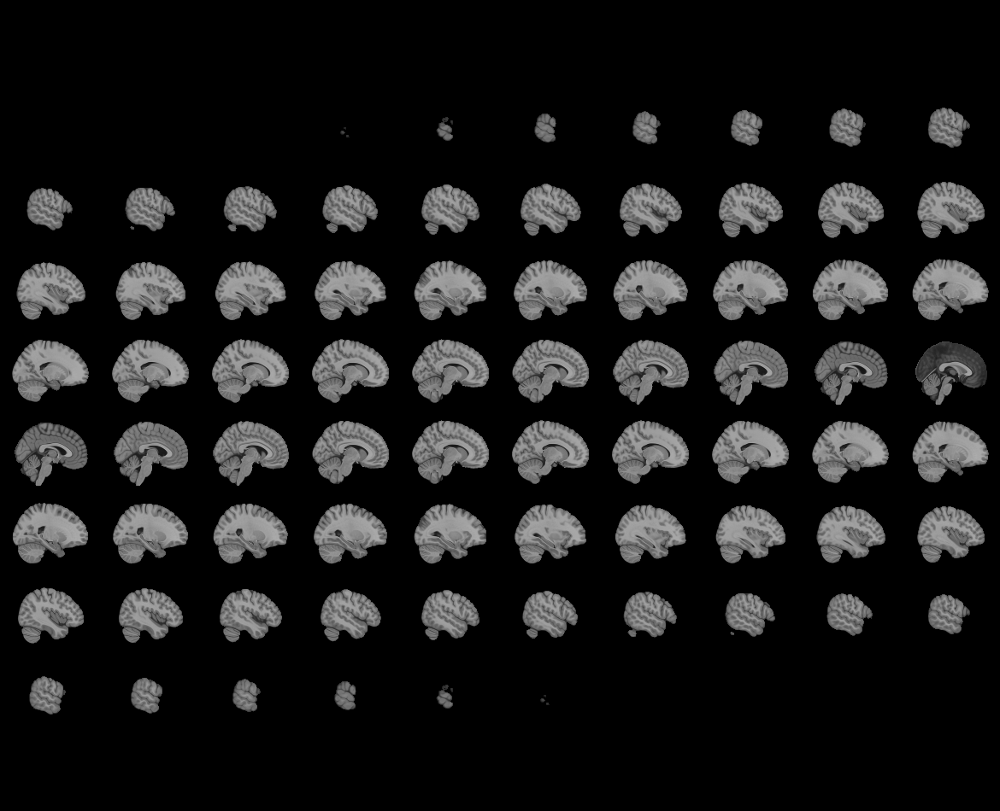
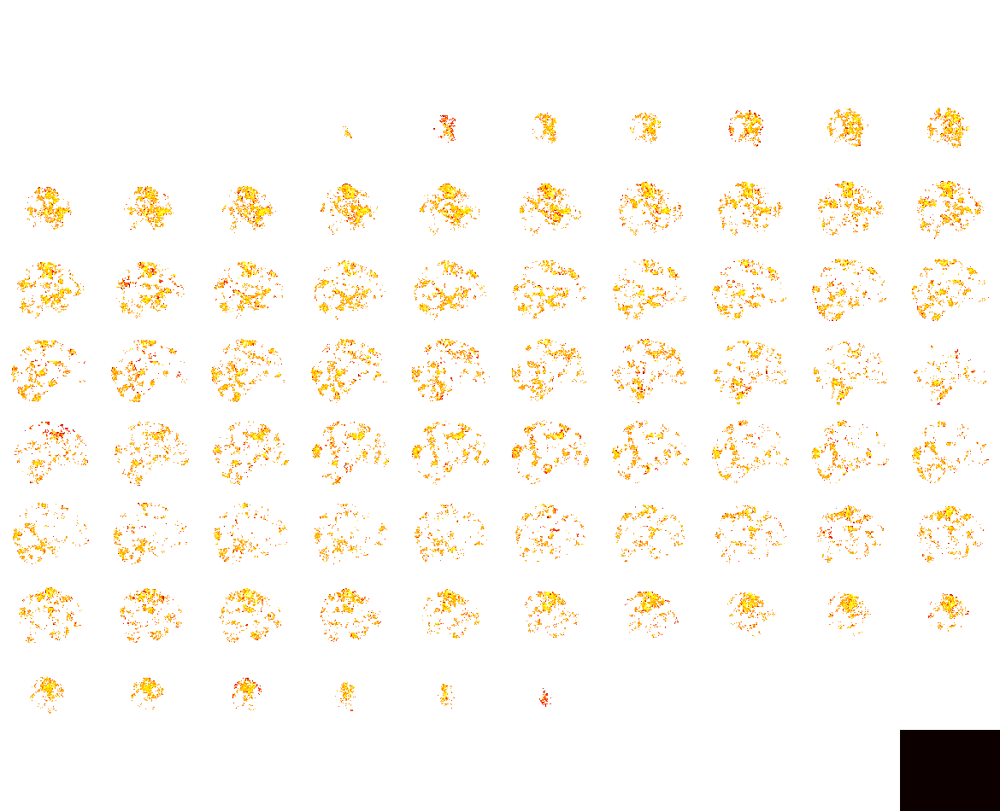

In [29]:
img_fpath = l1_fnames_mand[1][0]
print(img_fpath)
sub_name = os.path.basename(img_fpath)[:9]
plotting.view_img(img_fpath,
                  threshold=threshold,
                  cut_coords=[-42,-30,12],
                  symmetric_cmap=True,
                  title=sub_name)

In [21]:
texture = surface.vol_to_surf(img_fpath, fsaverage.pial_right)

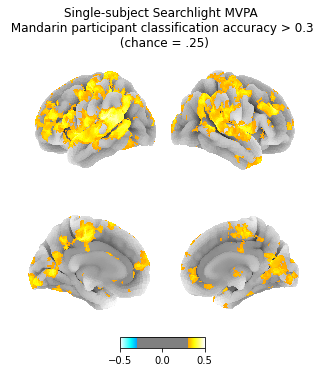

In [22]:
plotting.plot_img_on_surf(img_fpath,
                          #surf_mesh='fsaverage', # comment out for faster default (fsaverage5)
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          threshold=threshold,
                          vmax=0.5,
                          #cmap='Reds',
                          colorbar=True,
                          title=('Single-subject Searchlight MVPA '
                                 f'\n Mandarin participant classification accuracy > {threshold} '
                                 '\n (chance = .25)'))
plotting.show()

/scratch/slurm-2374457/ipykernel_20076/444892386.py:13: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig1.tight_layout()


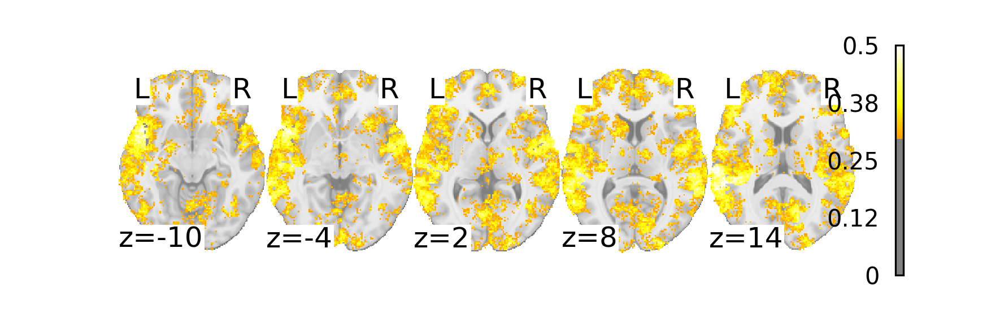

In [23]:
mni152_template = datasets.load_mni152_template(resolution=1)
fig1, ax1 = plt.subplots(figsize=(6,2), dpi=300)
plotting.plot_stat_map(img_fpath,
                       bg_img=mni152_template,
                       threshold=threshold,
                       vmax=0.5,
                       cut_coords=[-10, -4, 2, 8, 14],
                       display_mode='z',
                       colorbar=True, 
                       draw_cross=False, 
                       black_bg=False,
                       axes=ax1)
fig1.tight_layout()

In [24]:
mni152_template = datasets.load_mni152_template(resolution=1)

/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-3_stimulus_per_run_LSS/sub-FLT02_fwhm-0.0_mask-gm_searchmm-3_cond-tone_map-tstat_searchlight.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT03_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-3_stimulus_per_run_LSS/sub-FLT03_fwhm-0.0_mask-gm_searchmm-3_cond-tone_map-tstat_searchlight.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT06_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-3_stimulus_per_run_LSS/sub-FLT06_fwhm-0.0_mask-gm_searchmm-3_cond-tone_map-tstat_searchlight.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT09_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-3_stimulus_per_run_LSS/sub-FLT09_fwhm-0.0_mask-gm_search

/scratch/slurm-2374457/ipykernel_20076/1973003227.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(3, 1, figsize=(6,4), dpi=300)


/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT19_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT19_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT20_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT20_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT21_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT21_fwhm-0.0_mask-gm_searchmm-9_cond-tone_map-tstat_searchlight.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT22_space-MNI152NLin2009cAsym/mvpc-searchlight_fwhm-0.0_searchmm-9_stimulus_per_run_LSS/sub-FLT22_fwhm-0.0_mask-gm_search

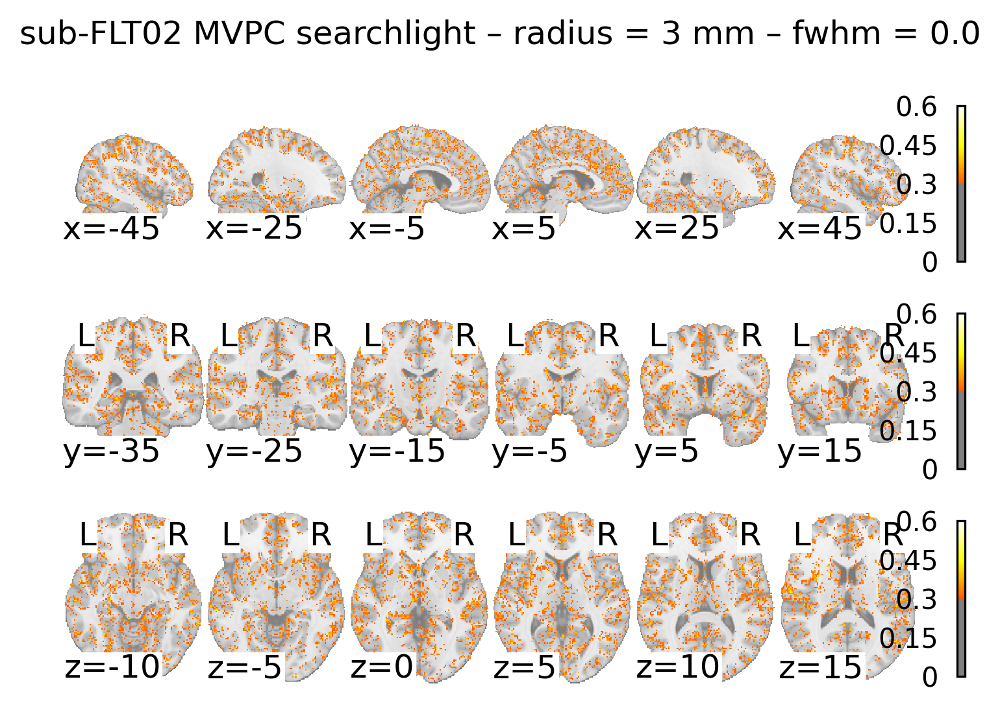

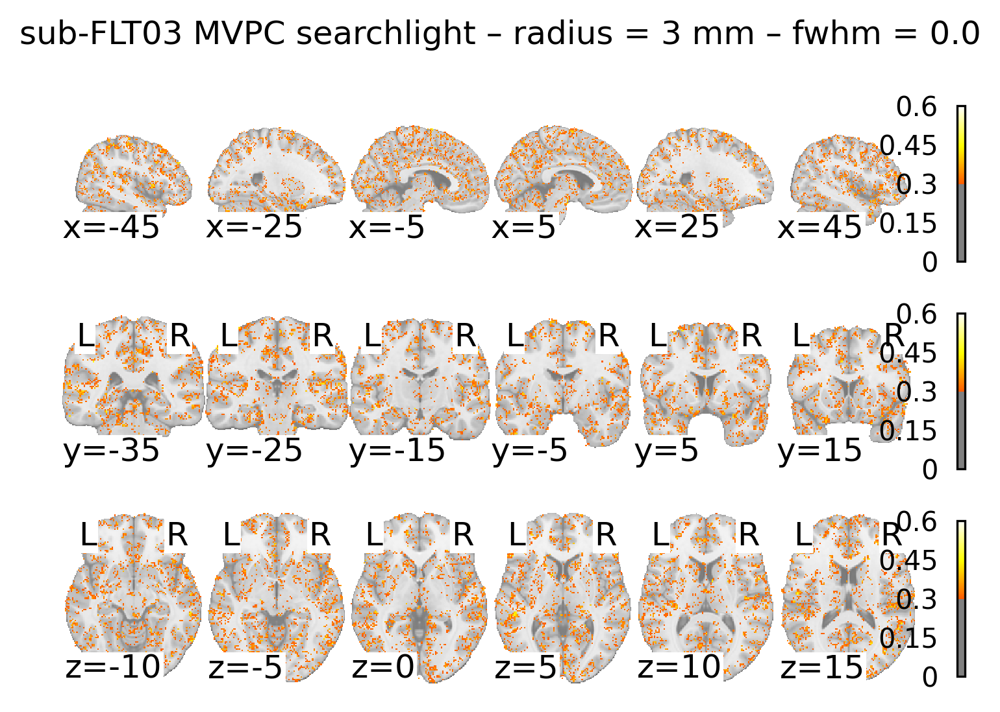

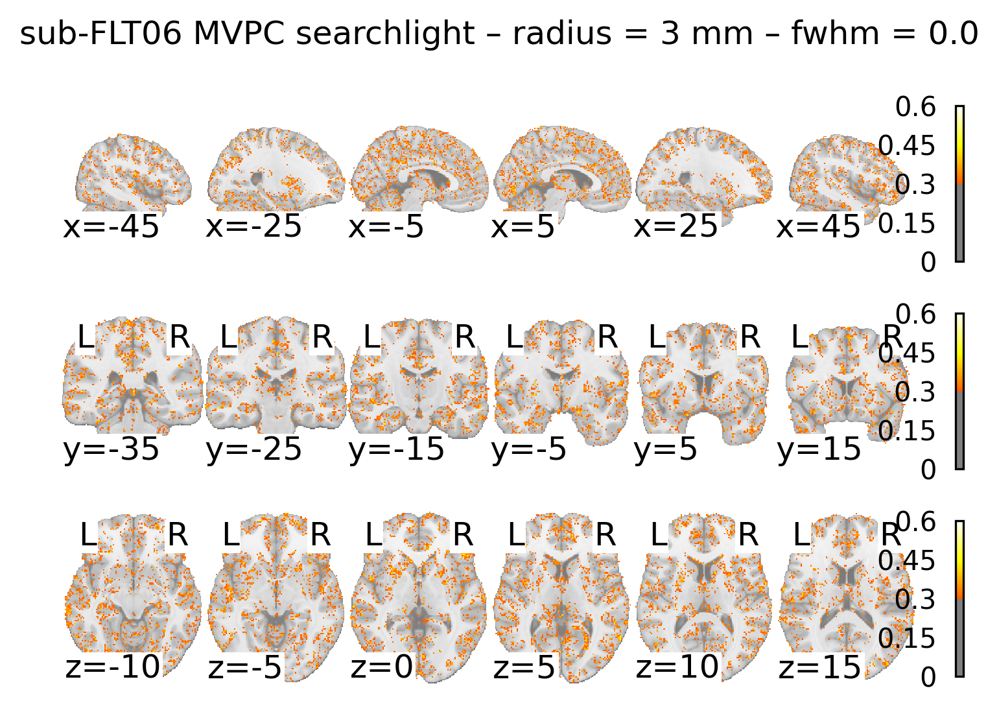

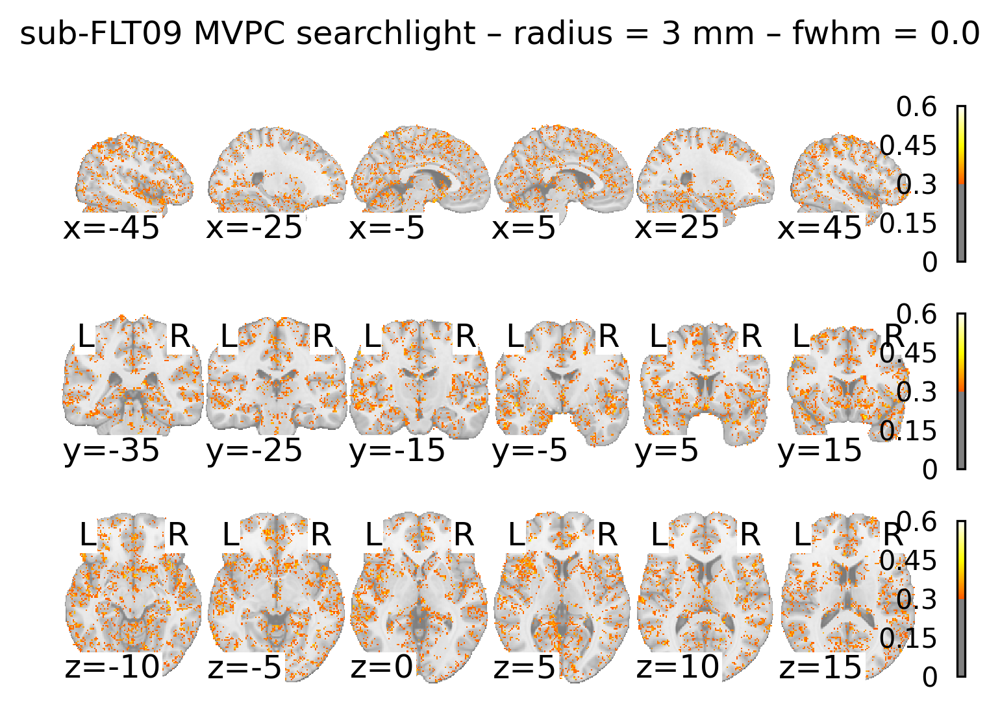

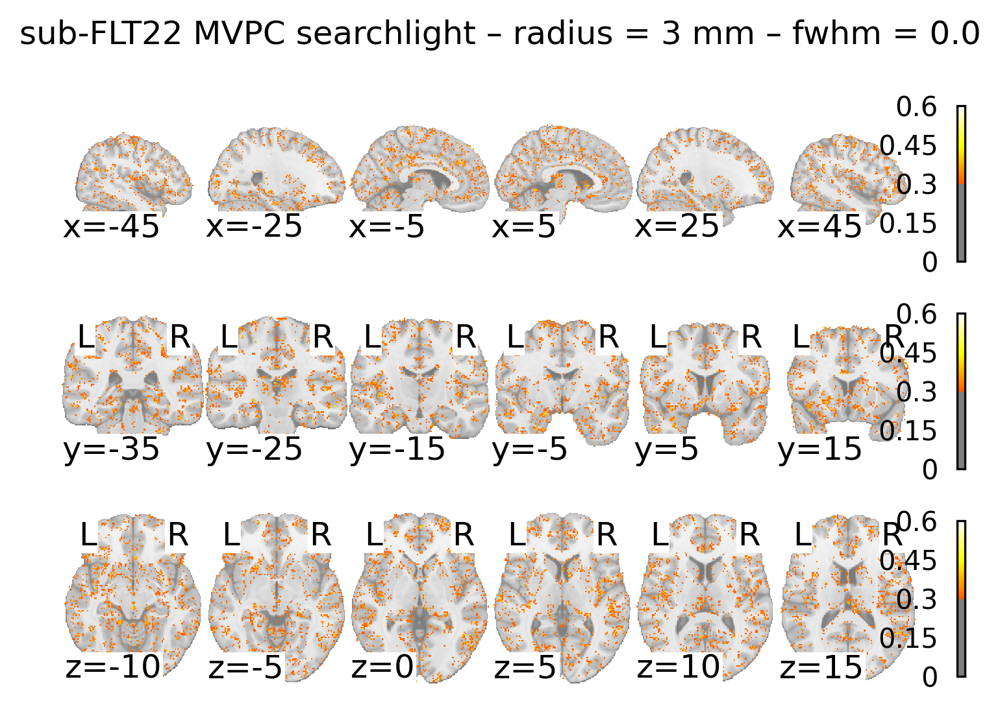

...

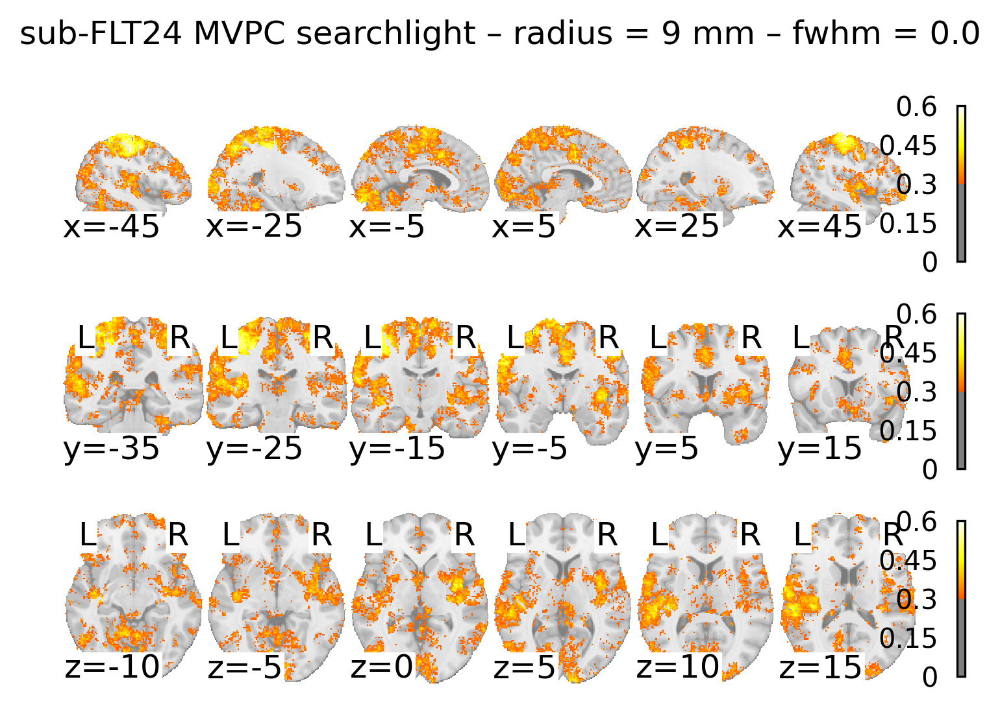

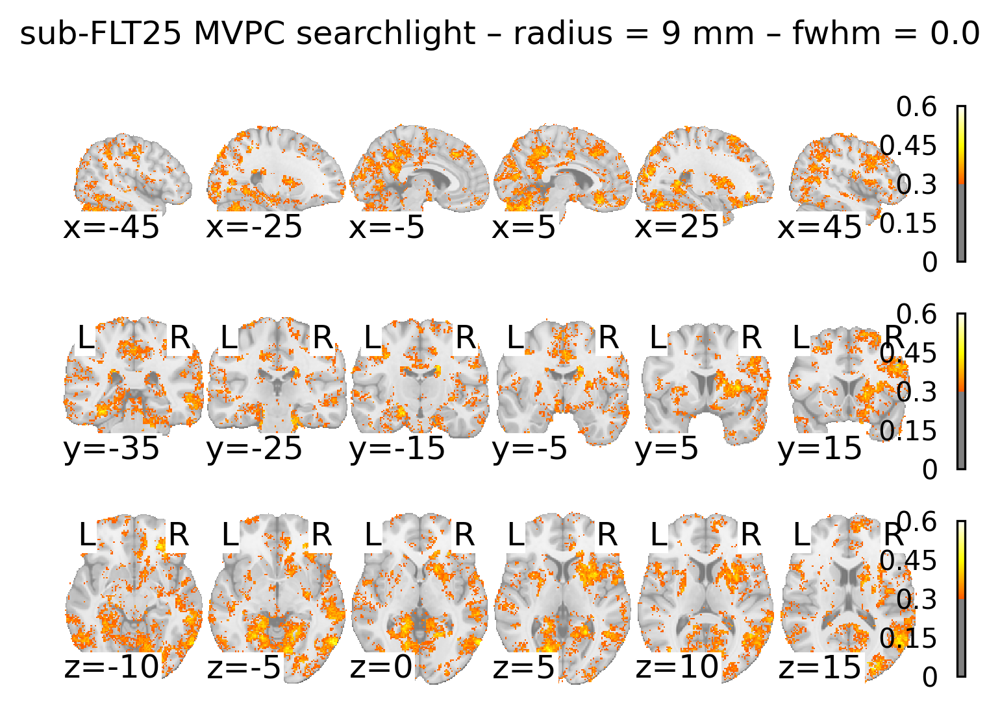

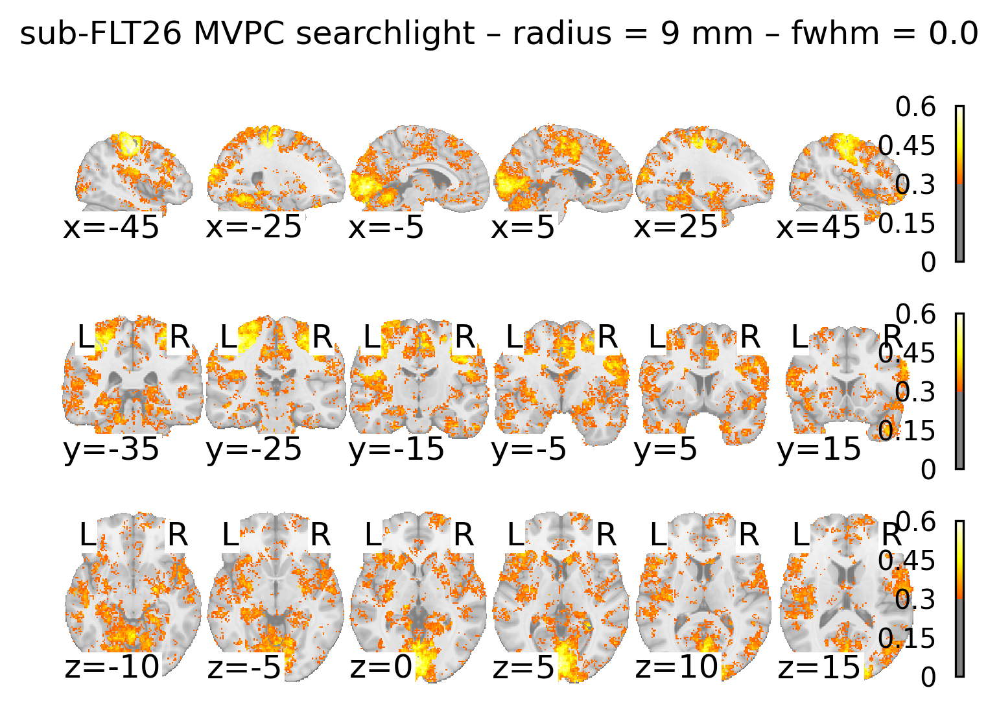

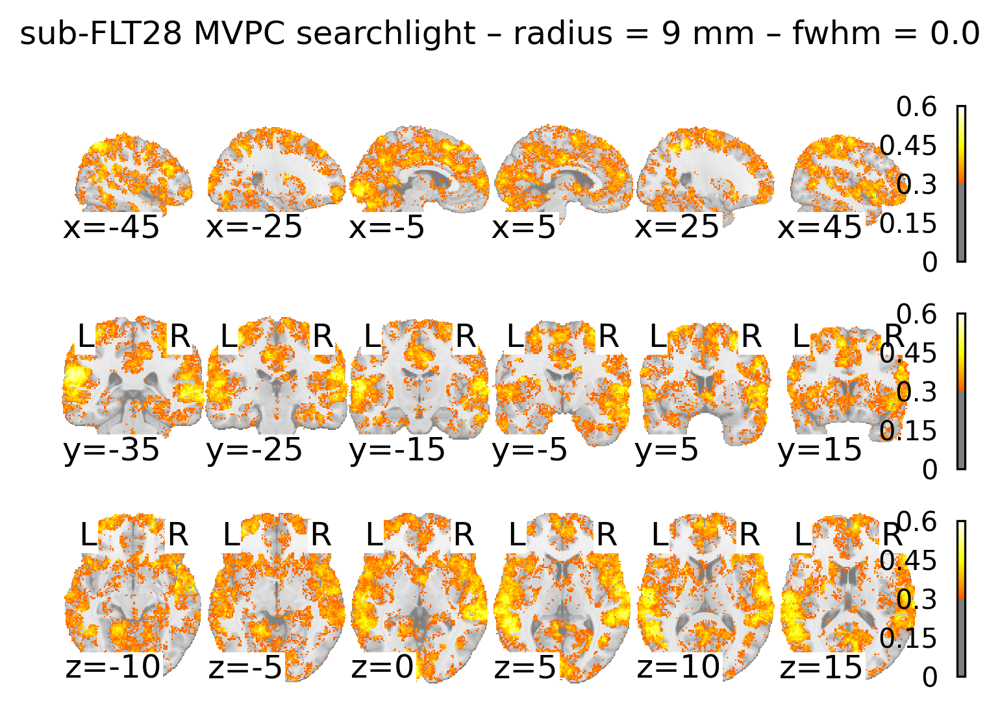

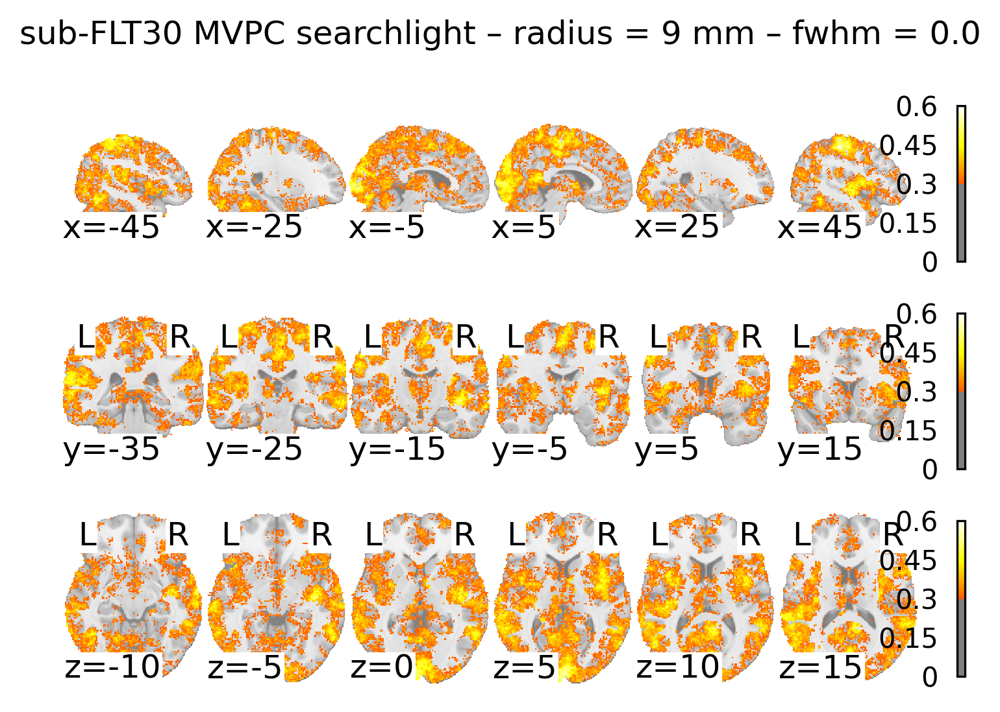

In [30]:
threshold = 0.3
for fx, fwhm in enumerate([0.00, 1.50]):
    for rx, search_radmm in enumerate([3, 6, 9, 12]):
        l1_fnames_groupdiff = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/mvpc-searchlight_fwhm-{fwhm}_searchmm-{search_radmm}_{model_label}*/*{cond_label}*.nii.gz')) for sub_id in subjects_label]
        for sx, sub_fpath_list in enumerate(l1_fnames_groupdiff):
            try: 
                img_fpath = sub_fpath_list[0]
                print(img_fpath)
                sub_id = subjects_label[sx]
                fig, ax = plt.subplots(3, 1, figsize=(6,4), dpi=300)
                plotting.plot_stat_map(img_fpath,
                                       bg_img=mni152_template,
                                       threshold=threshold,
                                       vmax=0.6,
                                       cut_coords=[-45, -25, -5, 5, 25, 45],
                                       display_mode='x',
                                       colorbar=True, 
                                       draw_cross=False, 
                                       black_bg=False,
                                       axes=ax[0])
                plotting.plot_stat_map(img_fpath,
                                       bg_img=mni152_template,
                                       threshold=threshold,
                                       vmax=0.6,
                                       cut_coords=[-35, -25, -15, -5, 5, 15],
                                       display_mode='y',
                                       colorbar=True, 
                                       draw_cross=False, 
                                       black_bg=False,
                                       axes=ax[1])
                plotting.plot_stat_map(img_fpath,
                                       bg_img=mni152_template,
                                       threshold=threshold,
                                       vmax=0.6,
                                       cut_coords=[-10, -5, 0, 5, 10, 15],
                                       display_mode='z',
                                       colorbar=True, 
                                       draw_cross=False, 
                                       black_bg=False,
                                       axes=ax[2])
                fig.suptitle(f'{sub_id} MVPC searchlight – radius = {search_radmm} mm – fwhm = {fwhm}')
                fig.savefig(f'level-1_den_mvpc-searchlight/{sub_id}_mvpc-searchlight_searchmm-{search_radmm}_fwhm-{fwhm}.png')
            except:
                pass

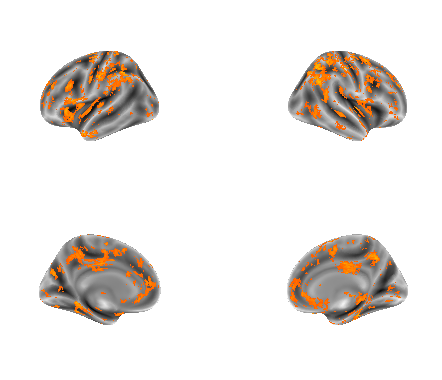

In [20]:
'''
threshold = 0.5

fig2, axes2 = plt.subplots(nrows=2, ncols=2, subplot_kw={"projection": "3d"}, figsize=(3,2), dpi=200)
#fig2.suptitle('Mandarin-speaking group (n = {}) \n z-thresh > {}, cluster thresh > {} voxels'.format(len(sub_list_mand), threshold, cthresh))

texture_left = surface.vol_to_surf(img_fpath, fsaverage.pial_left)
texture_right = surface.vol_to_surf(img_fpath, fsaverage.pial_right)

# left hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=1,
                            colorbar=False,
                            threshold=threshold, 
                            view='lateral',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[0,0], 
                            fig=fig2
                            )

# right hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=1,
                            colorbar=False,
                            threshold=threshold, 
                            view='lateral',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[0,1], 
                            fig=fig2
                            )

# left hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=1,
                            colorbar=False,
                            threshold=threshold, 
                            view='medial',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[1,0], 
                            fig=fig2
                            )

# right hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=1,
                            colorbar=False,
                            threshold=threshold, 
                            view='medial',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[1,1], 
                            fig=fig2
                            )
fig2.tight_layout()
fig2.show()
'''

#### test smoothing

In [34]:
from nilearn.image import smooth_img

In [36]:
img_fpath = l1_fnames_groupdiff[0]
smoothed_img = smooth_img(img_fpath, 3)

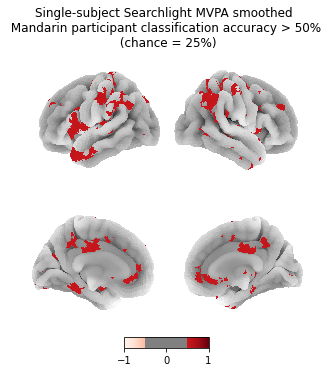

In [38]:
plotting.plot_img_on_surf(smoothed_img,
                          #surf_mesh='fsaverage', # comment out for faster default (fsaverage5)
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          threshold=0.50,
                          vmax=1.,
                          cmap='Reds',
                          colorbar=True,
                          title='Single-subject Searchlight MVPA smoothed \n Mandarin participant classification accuracy > 50% \n (chance = 25%)')
plotting.show()

## WIP: parametric accuracy minus chance

#### loop through images and subtract 0.25 (chance) if above chance

In [14]:
from nilearn.image import new_img_like

In [15]:
chance_acc = 0.25
diff_img_list = []

for mask_label in ['gm_cond-tone']:
    print(mask_label)
    mask_sl_thr_array = []

    for sx, sub_id in enumerate(subjects_label):
        sub_mask_sl_fpath = os.path.join(nilearn_dir, 'level-1_fwhm-1.50', '%s_space-%s'%(sub_id, space_label), search_label, 
                                         '{}_space-{}_mask-{}_searchlight.nii.gz'.format(sub_id, space_label, mask_label))
        sub_sl_img = nib.load(sub_mask_sl_fpath)

        sub_sl_data = sub_sl_img.get_fdata()

        # subtract chance accuracies
        diff_data = sub_sl_data - chance_acc
        # if below 0, move to 0 (no such thing as negative chance)
        diff_data[diff_data < 0] = 0

        diff_img = new_img_like(sub_sl_img, diff_data)

        diff_img_list.append(diff_img)

gm_cond-tone


### First-level parametrics stats on accuracy-minus-chance images

In [16]:
from nilearn.mass_univariate import permuted_ols

In [17]:
permuted_ols(diff_img_list)

TypeError: permuted_ols() missing 1 required positional argument: 'target_vars'

#### Mandarin-speaking participants group accuracy

In [30]:
second_level_model = SecondLevelModel().fit(diff_img_list, design_matrix=design_mat_groupdiff)

z_map = second_level_model.compute_contrast(second_level_contrast=[1, 0,], output_type='z_score')

In [38]:
from nilearn.image import threshold_img
threshold = 7
cthresh = 10
thresholded_map = threshold_img(
                                z_map,
                                threshold=threshold,
                                cluster_threshold=cthresh,
                                two_sided=False,
                            )

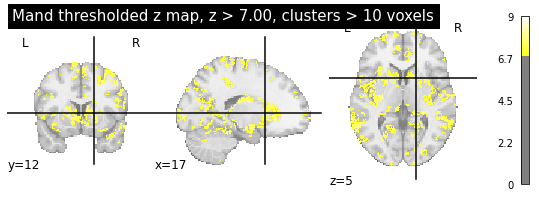

In [39]:
plotting.plot_stat_map(
    thresholded_map, cut_coords=[17,12,5], 
    threshold=threshold,
    title='Mand thresholded z map, z > %.02f, clusters > %d voxels'%(threshold, cthresh))

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



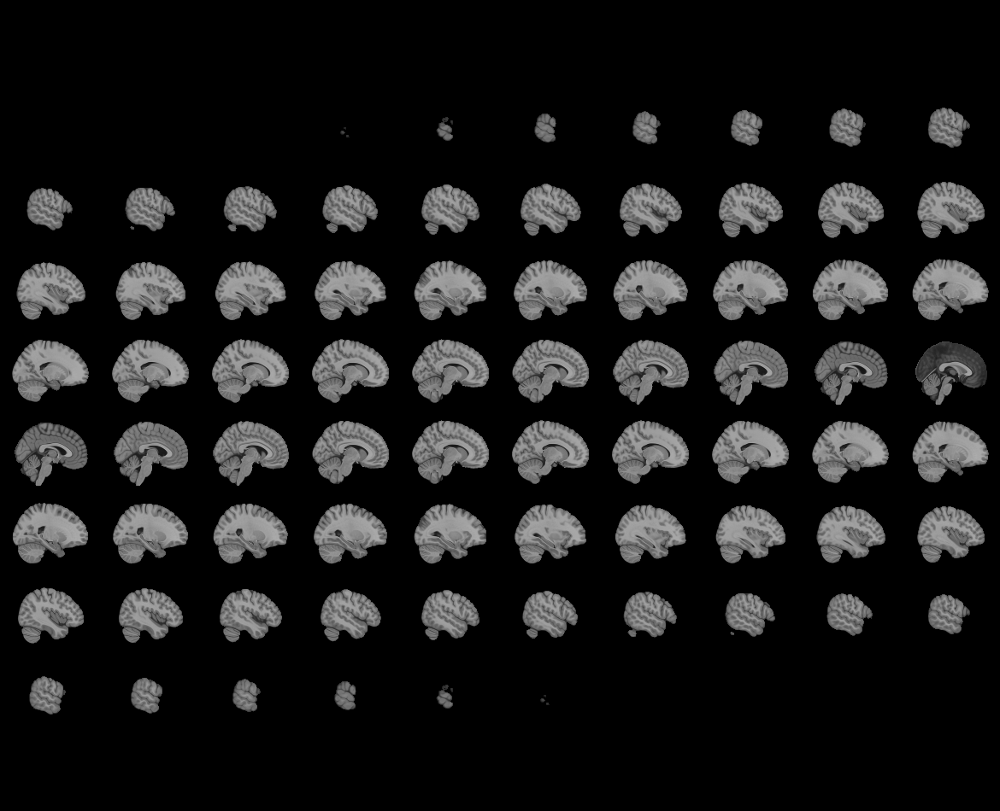
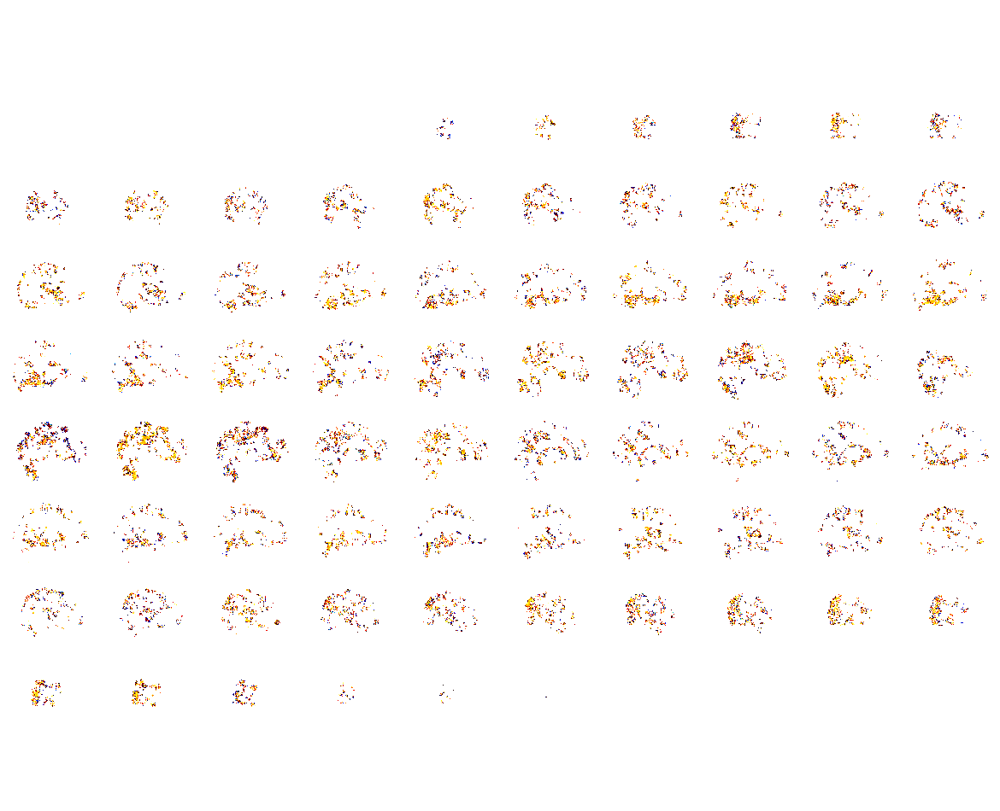

In [40]:
plotting.view_img(thresholded_map,
                  threshold=threshold,
                  symmetric_cmap=False)

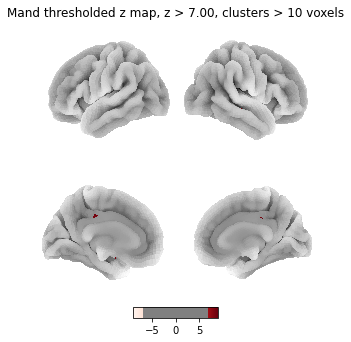

In [41]:
plotting.plot_img_on_surf(thresholded_map,
                          #surf_mesh='fsaverage', # comment out for faster default (fsaverage5)
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          threshold=threshold,
                          cmap='Reds',
                          colorbar=True,
                          title='Mand thresholded z map, z > %.02f, clusters > %d voxels'%(threshold, cthresh))
plotting.show()

#### Group differences in searchlight accuracy

In [50]:
z_map_diff = second_level_model.compute_contrast(second_level_contrast=[1, -1,], output_type='z_score')

In [51]:
from nilearn.image import threshold_img
threshold = 3.09
cthresh = 10
thresh_diff_map = threshold_img(
                                z_map_diff,
                                threshold=threshold,
                                cluster_threshold=cthresh,
                                two_sided=False,
                            )

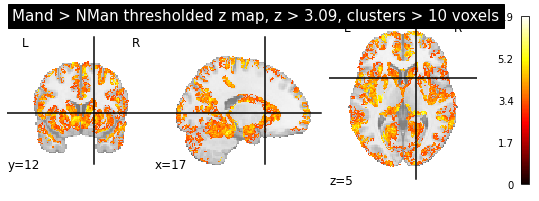

In [52]:
plotting.plot_stat_map(
    thresh_diff_map, cut_coords=[17,12,5], 
    title='Mand > NMan thresholded z map, z > %.02f, clusters > %d voxels'%(threshold, cthresh))

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



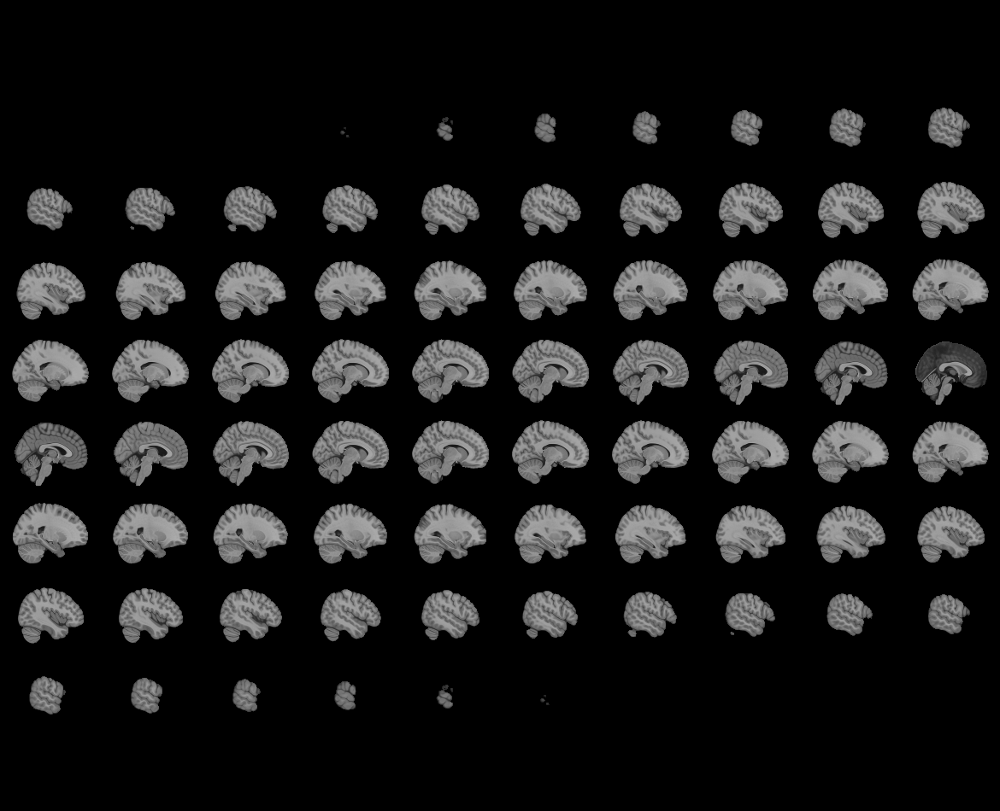
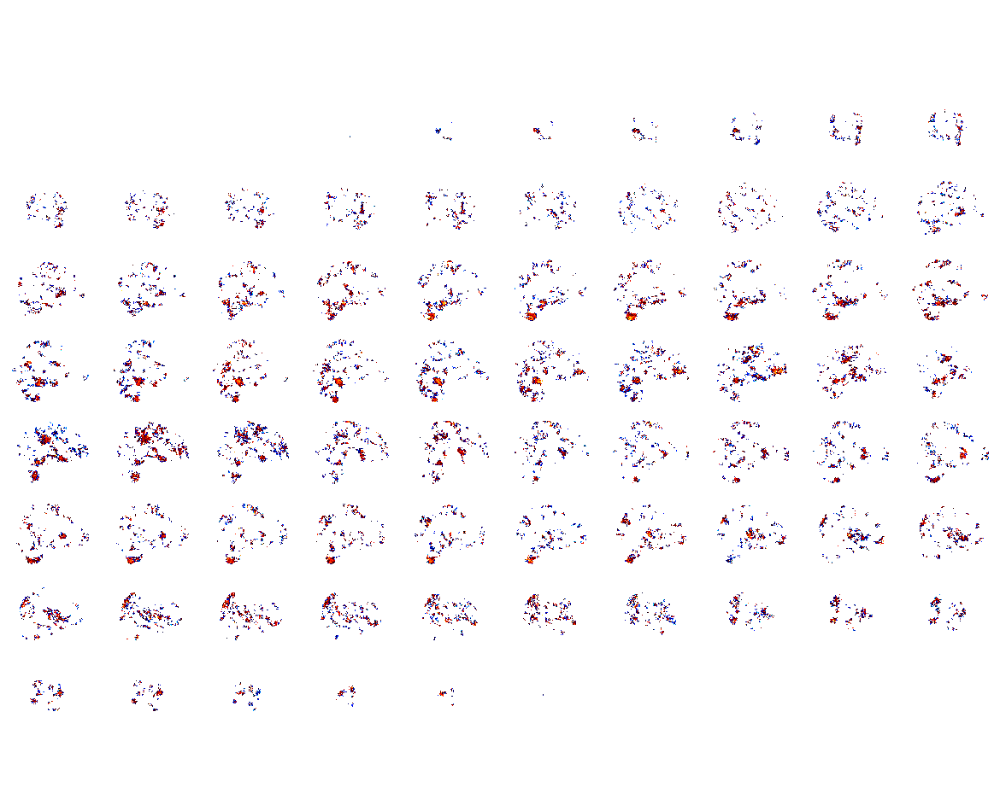

In [51]:
plotting.view_img(thresh_diff_map,
                  threshold=threshold,
                  symmetric_cmap=False)

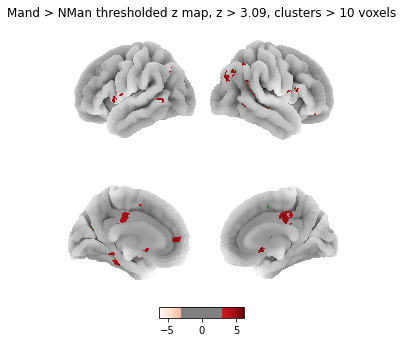

In [54]:
plotting.plot_img_on_surf(thresh_diff_map,
                          #surf_mesh='fsaverage', # comment out for faster default (fsaverage5)
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          threshold=threshold,
                          cmap='Reds',
                          colorbar=True,
                          title='Mand > NMan thresholded z map, z > %.02f, clusters > %d voxels'%(threshold, cthresh))
plotting.show()